In [2]:
## Enable matplotlib inline
%matplotlib inline
import matplotlib.pyplot as plt

## Imports
import pandas as pd
pd.set_option('mode.chained_assignment',None)
pd.set_option('display.mpl_style', 'default') 
pd.set_option('display.width', 5000) 
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 200)

import numpy as np
from sklearn import ensemble
from sklearn import metrics

In [3]:
gifts_df = pd.read_csv('gifts.csv')

In [4]:
x = gifts_df['Longitude'].values
y = gifts_df['Latitude'].values
w = gifts_df['Weight'].values

In [5]:
from cv2 import imread, cvtColor, COLOR_BGR2RGB


## ----------------------------------------------
def read_image(path):
    """
    Read an image and convert to RGB using openCV
    """
    img = imread(path)
    return cvtColor(img, COLOR_BGR2RGB)

In [29]:
earth = read_image('earth.jpg')

In [7]:
def transform(x,y):
    """
    transform the latitude/longitude coordinates to the coordinates of the image
    """
    
    new_x = (x + 180)*(earth.shape[1]/360.0)
    new_y = -(y - 90)*(earth.shape[0]/180.0)
    
    return new_x, new_y

/usr/local/lib/python2.7/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


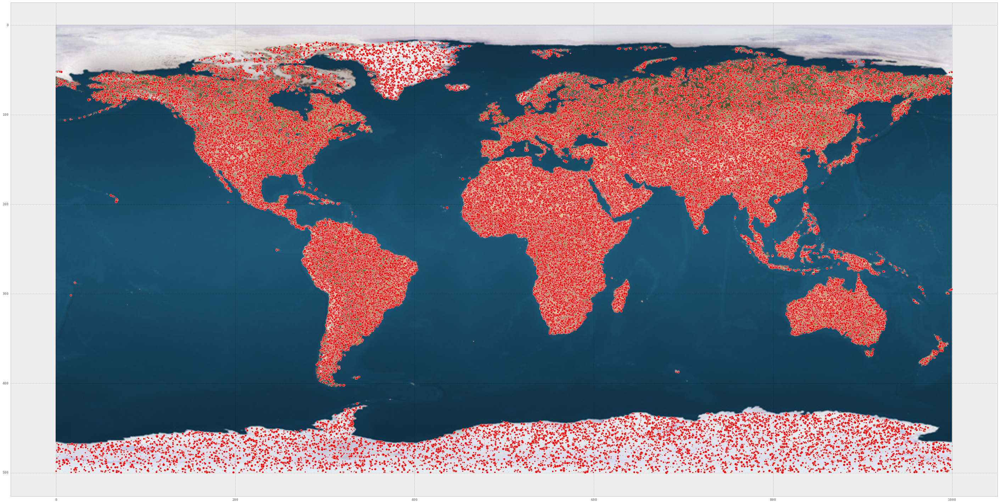

In [8]:
x_, y_ = transform(x,y)

plt.figure(figsize=(50,25))
plt.imshow(earth)
plt.scatter(x_, y_, s=w, c='red')

In [9]:
import math

## --------------------------------------------------
def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(math.radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = math.sin(dlat/2)**2 + math.cos(lat1) * math.cos(lat2) * math.sin(dlon/2)**2
    c = 2 * math.asin(math.sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    return c * r

In [10]:
NP = (0, 90)

gifts_df['current_Longitude'] = NP[0]
gifts_df['current_Latitude']  = NP[1]
gifts_df['done'] = False

In [13]:
import time

answers = []
trip = 1
gift_order = 0
counter = 0
current_weight = 10.0

current_time = time.time()

df = gifts_df[:]

while len(df):
    
    counter += 1
    
    ## Calculate distance to the current point
    df['distance'] = map(
        haversine,
        df['Longitude'],
        df['Latitude'],
        df['current_Longitude'],
        df['current_Latitude']
    )
    
    ## sort by order of increasing distance
    df = df.sort_values(by='distance')
    
    ## Retrieve data for the closest gift
    weight = df['Weight'].values[0]
    
    ## If the addition of the current best gift makes the weight go overboard, start new trip
    if current_weight + weight > 1000.0:
        
        print 'iteration:', counter, 'trip completed:', trip, 'remaining gifts:', len(df), 'dt:',
        this_time = time.time()
        print this_time - current_time
        current_time = time.time()
        
        trip += 1
        gift_order = 0
        df['current_Longitude'] = NP[0]
        df['current_Latitude'] = NP[1]
        current_weight = 10.0
        
        continue
        
    current_weight += weight
        
    gift_id   = df['GiftId'].values[0]
    df['current_Longitude'] = df['Longitude'].values[0]
    df['current_Latitude']  = df['Latitude'].values[0]
    df['done'].values[0] = True
    
    answers.append((trip, gift_id, gift_order))
    gift_order += 1
    
    ## Get rid of the gifts already treated
    df = df[1:]
    
    
    

iteration: 76 trip completed: 1 remaining gifts: 99925 dt: 15.1618001461
iteration: 154 trip completed: 2 remaining gifts: 99848 dt: 16.5620210171
iteration: 233 trip completed: 3 remaining gifts: 99770 dt: 16.997166872
iteration: 310 trip completed: 4 remaining gifts: 99694 dt: 15.7738211155
iteration: 382 trip completed: 5 remaining gifts: 99623 dt: 15.5265569687
iteration: 441 trip completed: 6 remaining gifts: 99565 dt: 12.6002418995
iteration: 514 trip completed: 7 remaining gifts: 99493 dt: 16.1697900295
iteration: 588 trip completed: 8 remaining gifts: 99420 dt: 16.1965031624
iteration: 667 trip completed: 9 remaining gifts: 99342 dt: 16.4312610626
iteration: 735 trip completed: 10 remaining gifts: 99275 dt: 13.3694310188
iteration: 803 trip completed: 11 remaining gifts: 99208 dt: 13.4576981068
iteration: 883 trip completed: 12 remaining gifts: 99129 dt: 15.7132880688
iteration: 938 trip completed: 13 remaining gifts: 99075 dt: 10.4889979362
iteration: 1015 trip completed: 14 r

In [19]:
answers

[(1, 66128, 0),
 (1, 90431, 1),
 (1, 60369, 2),
 (1, 37147, 3),
 (1, 69572, 4),
 (1, 21808, 5),
 (1, 14647, 6),
 (1, 23554, 7),
 (1, 49287, 8),
 (1, 81895, 9),
 (1, 98527, 10),
 (1, 80194, 11),
 (1, 10033, 12),
 (1, 92459, 13),
 (1, 28139, 14),
 (1, 7867, 15),
 (1, 1264, 16),
 (1, 94010, 17),
 (1, 22174, 18),
 (1, 46996, 19),
 (1, 7856, 20),
 (1, 3374, 21),
 (1, 80013, 22),
 (1, 22896, 23),
 (1, 42128, 24),
 (1, 96086, 25),
 (1, 94856, 26),
 (1, 41996, 27),
 (1, 27596, 28),
 (1, 26242, 29),
 (1, 35787, 30),
 (1, 29970, 31),
 (1, 55854, 32),
 (1, 89995, 33),
 (1, 9640, 34),
 (1, 88925, 35),
 (1, 87760, 36),
 (1, 35388, 37),
 (1, 66008, 38),
 (1, 89936, 39),
 (1, 37128, 40),
 (1, 80720, 41),
 (1, 5556, 42),
 (1, 33335, 43),
 (1, 46221, 44),
 (1, 2103, 45),
 (1, 23658, 46),
 (1, 15625, 47),
 (1, 49408, 48),
 (1, 20675, 49),
 (1, 66386, 50),
 (1, 92069, 51),
 (1, 31818, 52),
 (1, 99076, 53),
 (1, 24044, 54),
 (1, 90017, 55),
 (1, 32870, 56),
 (1, 57629, 57),
 (1, 56140, 58),
 (1, 18197, 59

In [20]:
a = np.array(answers)
answer_df = pd.DataFrame(a, columns=['TripId', 'GiftId', 'GiftOrder'])
#answer_df = answer_df[['GiftId', 'TripId']]
#answer_df.to_csv('trips.csv', index=False)

In [22]:
gifts_df = pd.merge(gifts_df, answer_df)

In [23]:
x = gifts_df['Longitude'].values
y = gifts_df['Latitude'].values
w = gifts_df['Weight'].values
t = gifts_df['TripId'].values

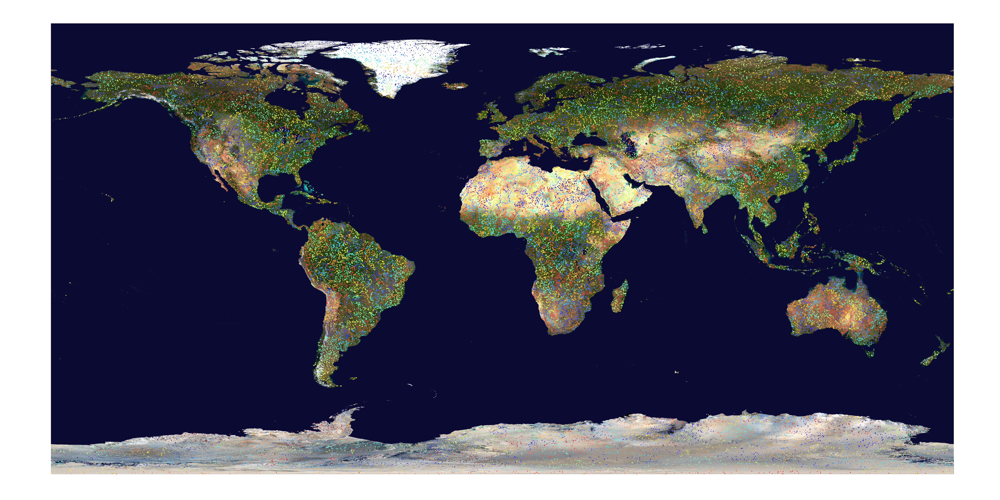

In [30]:
x_, y_ = transform(x,y)
fig = plt.figure(frameon=False)
fig.set_size_inches(100,50)

ax = plt.Axes(fig, [0., 0., 1., 1.])
ax.set_axis_off()
fig.add_axes(ax)

ax.imshow(earth, aspect='normal')
ax.scatter(x_, y_, s=w, c=t%50)
fig.savefig('trips.png')

In [32]:
## define a haversine that uses numpy functions
gifts_df

,GiftId,Latitude,Longitude,Weight,current_Longitude,current_Latitude,done,TripId,GiftOrder
0,1,16.345769,6.303545,1.000000,0,90,False,846,3
1,2,12.494749,28.626396,15.524480,0,90,False,829,49
2,3,27.794615,60.032495,8.058499,0,90,False,621,26
3,4,44.426992,110.114216,1.000000,0,90,False,349,40
4,5,-69.854088,87.946878,25.088892,0,90,False,1283,52
5,6,53.567970,-71.359308,38.000151,0,90,False,310,1
6,7,12.902584,79.966949,44.206616,0,90,False,836,33
7,8,-6.291099,-64.891751,1.000000,0,90,False,1029,52
8,9,-2.685316,111.089758,1.000000,0,90,False,970,67
9,10,38.428862,101.973671,35.701311,0,90,False,488,14


In [33]:
### Trying to compute a minimum bound on the final score
## Every gift needs to be taken from the North Pole to their delivery location, meaning every gift
## travels the minimum distance of NP -> delivery location, irrespective of the trip structure. This is
## the first component of the minimum bound

gifts_df['current_Longitude'] = NP[0]
gifts_df['current_Latitude']  = NP[1]

gifts_df['distance'] = map(
    haversine,
    gifts_df['Longitude'],
    gifts_df['Latitude'],
    gifts_df['current_Longitude'],
    gifts_df['current_Latitude']
)

gifts_df['work'] = gifts_df['distance'] * gifts_df['Weight']
minimum_score = 0
minimum_score += gifts_df['work'].sum()
print minimum_score

12042715198.6


In [35]:
## The next component to take into account is the return trips. For this purpose, we must estimate a minimum
## number of trips. Let's sum the total weight of all gifts, and divide by 990, and round up.
total_weight = gifts_df['Weight'].sum()
n_trips = int(total_weight/990)
print n_trips

1424


In [36]:
## Let's do some toys: I need to sample 1424 gifts (last gift for every trip) and sum up the distance to the north pole
return_distances = []
for i in range(1000):
    return_distance = gifts_df.sample(n_trips)['distance'].sum()
    return_distances.append(return_distance)
    
return_distances = np.array(return_distances)
return_distance = np.mean(return_distances)
print return_distance

12157877.6719


In [37]:
## Let's multiply that distance by 10, the weight of the sleigh and add to the minimum score
minimum_score += return_distance*10
print minimum_score

12164293975.4


In [38]:
## Calculate how far the current leader (12/10/2015) is from this theoretical minimum
leader = 12414494952.29290
(leader - minimum_score)/minimum_score

0.020568475033500642

In [ ]:
## I think I should design an algorithm that comes up with paths that are as straight-down as possible,
## but also as short as possible. It's a threefold optimization:
##  - Straight down is the priority, so one criteria has to be the difference between the current longitude and
##    the next gift's longitude. There may need to be some sort of weighting according to the latitude: deviating
##    in longitude near the poles is not nearly as bad as deviating near the equator
##  - Shorter distance comes second, in order to minimize the length of the return trip